# Notes

We provide this notebook for inference and visualizations.

You can either load images from a dataloader(see Sec. 1) or from a local path(see Sec. 2).

Welcome to join [IDEA](https://idea.edu.cn/en)([中文网址](https://idea.edu.cn/))!

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!git clone https://github.com/IDEA-Research/DINO.git
import os
os.chdir('/content/DINO')

Cloning into 'DINO'...
remote: Enumerating objects: 442, done.
remote: Counting objects: 100% (191/191), done.
remote: Compressing objects: 100% (95/95), done.
remote: Total 442 (delta 136), reused 96 (delta 96), pack-reused 251 (from 1)
Receiving objects: 100% (442/442), 13.43 MiB | 17.46 MiB/s, done.
Resolving deltas: 100% (191/191), done.


In [ ]:
!pip install -r requirements.txt

  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-install-2bgrbp41/pycocotools_6da52eea7d6644fdbe1ce7326c87c373
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/cocoapi.git /tmp/pip-install-2bgrbp41/pycocotools_6da52eea7d6644fdbe1ce7326c87c373
  Resolved https://github.com/cocodataset/cocoapi.git to commit 8c9bcc3cf640524c4c20a9c40e89cb6a2f2fa0e9
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/cocodataset/panopticapi.git to /tmp/pip-install-2bgrbp41/panopticapi_732e610417404f3f840fe609c3c192e9
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/panopticapi.git /tmp/pip-install-2bgrbp41/panopticapi_732e610417404f3f840fe609c3c192e9
  Resolved https://github.com/cocodataset/panopticapi.git to commit 7bb4655548f98f3fedc07bf37e9040a992b054b0
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━

In [ ]:
!pwd

/content/DINO


In [ ]:
import os, sys
import torch, json
import numpy as np

from main import build_model_main
from util.slconfig import SLConfig
from datasets import build_dataset
from util.visualizer import COCOVisualizer
from util import box_ops

# 0. Initialize and Load Pre-trained Models

In [ ]:
!cd models/dino/ops
!python "/content/DINO/models/dino/ops/setup.py" build_ext --inplace
!pip install .

running build_ext
/usr/local/lib/python3.10/dist-packages/torch/utils/cpp_extension.py:495: UserWarning: Attempted to use ninja as the BuildExtension backend but we could not find ninja.. Falling back to using the slow distutils backend.
  warnings.warn(msg.format('we could not find ninja.'))
/usr/local/lib/python3.10/dist-packages/torch/utils/cpp_extension.py:414: UserWarning: The detected CUDA version (12.2) has a minor version mismatch with the version that was used to compile PyTorch (12.1). Most likely this shouldn't be a problem.
  warnings.warn(CUDA_MISMATCH_WARN.format(cuda_str_version, torch.version.cuda))
/usr/local/lib/python3.10/dist-packages/torch/utils/cpp_extension.py:424: UserWarning: There are no x86_64-linux-gnu-g++ version bounds defined for CUDA version 12.2
  warnings.warn(f'There are no {compiler_name} version bounds defined for CUDA version {cuda_str_version}')
building 'MultiScaleDeformableAttention' extension
creating build
creating build/temp.linux-x86_64-cpyt

In [ ]:
model_config_path = "config/DINO/DINO_4scale.py" # change the path of the model config file
model_checkpoint_path = "/content/drive/MyDrive/IITDVision/fine-tuned-checkpoint.pth" # change the path of the model checkpoint
# See our Model Zoo section in README.md for more details about our pretrained models.

In [ ]:
torch.__version__

'2.4.1+cu121'

In [ ]:
args = SLConfig.fromfile(model_config_path)
args.device = 'cuda'
model, criterion, postprocessors = build_model_main(args)
checkpoint = torch.load(model_checkpoint_path, map_location='cpu')
model.load_state_dict(checkpoint['model'])
_ = model.eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 162MB/s]
<ipython-input-9-72ca36f16c8d>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possib

In [ ]:
!pwd

/content/DINO


In [ ]:
# load coco names
with open('util/coco_id2name.json') as f:
    id2name = json.load(f)
    id2name = {int(k):v for k,v in id2name.items()}

# 1. Visualize images from a dataloader
## 1.1 Load Datasets

In [ ]:
args.dataset_file = 'coco'
args.coco_path = "/content/drive/MyDrive/IITDVision/datasetv2/images" # the path of coco
args.fix_size = False

#dataset_val = build_dataset(image_set='val', args=args)
dataset_val = build_dataset(image_set='val', args=args)

data_aug_params: {
  "scales": [
    480,
    512,
    544,
    576,
    608,
    640,
    672,
    704,
    736,
    768,
    800
  ],
  "max_size": 1333,
  "scales2_resize": [
    400,
    500,
    600
  ],
  "scales2_crop": [
    384,
    600
  ]
}
loading annotations into memory...
Done (t=2.36s)
creating index...
index created!


## 1.2 Get an Example and Visualize it

In [ ]:
dataset_val

Dataset CocoDetection
    Number of datapoints: 40
    Root location: /content/drive/MyDrive/IITDVision/datasetv2/images/val2017

In [ ]:
image, targets = dataset_val[6]

## 1.3 Visualize Model Predictions

In [ ]:
vslzr = COCOVisualizer()

In [ ]:
from torchvision.ops import box_iou

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
def cxcywh_to_xyxy(boxes):
    # Convert [cx, cy, w, h] -> [x_min, y_min, x_max, y_max]
    cx, cy, w, h = boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3]
    x_min = cx - 0.5 * w
    y_min = cy - 0.5 * h
    x_max = cx + 0.5 * w
    y_max = cy + 0.5 * h
    return torch.stack([x_min, y_min, x_max, y_max], dim=1)

In [ ]:
def calculate_ap(precision, recall):
    # Add zero at the start of recall and precision
    recall = torch.cat([torch.Tensor([0.0]).to(device), recall])
    precision = torch.cat([torch.Tensor([0.0]).to(device), precision])

    # Interpolation: precision should be non-decreasing
    for i in range(len(precision) - 1, 0, -1):
        precision[i - 1] = torch.maximum(precision[i - 1], precision[i])

    # Compute AP as area under curve
    indices = torch.where(recall[1:] != recall[:-1])[0] + 1
    ap = torch.sum((recall[indices] - recall[indices - 1]) * precision[indices])

    return ap

In [ ]:
output = model.cuda()(image[None].cuda())
output = postprocessors['bbox'](output, torch.Tensor([[1.0, 1.0]]).cuda())[0]

/usr/local/lib/python3.10/dist-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
threshold = 0.3 # set a threshold

scores = output['scores']
labels = output['labels']
boxes = box_ops.box_xyxy_to_cxcywh(output['boxes'])
select_mask = scores > threshold

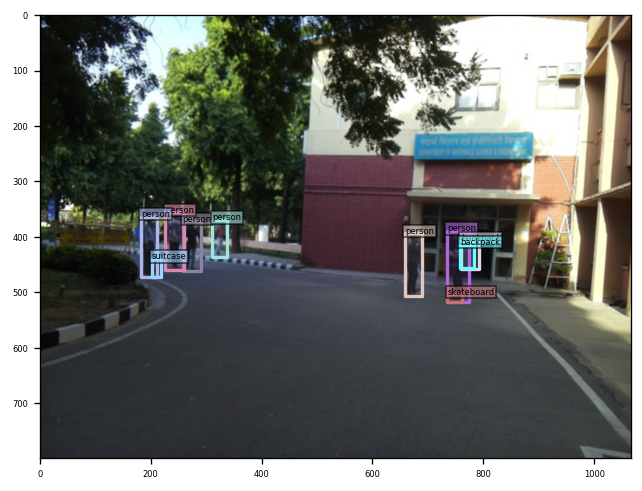

savename: /content//33-2024-09-23-13:12:21.447752.png


In [ ]:
box_label = [id2name[int(item)] for item in labels[select_mask]]
pred_dict = {
    'boxes': boxes[select_mask],
    'size': targets['size'],
    'box_label': box_label,
    'image_id': targets['image_id']
}
vslzr.visualize(image, pred_dict, savedir=None)

In [ ]:
# Filter the predictions for the "person" class
person_mask = [label == "person" for label in box_label]
person_boxes = boxes[select_mask][person_mask]
person_scores = scores[select_mask][person_mask]

In [ ]:
# Correct way to find the index for the "person" class
person_class_id = [key for key, value in id2name.items() if value == "person"][0]

# Get ground truth boxes for "person"
gt_person_mask = targets['labels'] == person_class_id
gt_person_boxes = targets['boxes'][gt_person_mask]

In [ ]:
# image_width, image_height = targets['size']

# # Convert from cxcywh to absolute pixel coordinates
# person_boxes_abs = person_boxes.clone()
# person_boxes_abs[:, 0] *= image_width  # center_x to absolute x
# person_boxes_abs[:, 1] *= image_height  # center_y to absolute y
# person_boxes_abs[:, 2] *= image_width  # width to absolute width
# person_boxes_abs[:, 3] *= image_height  # height to absolute height

# gt_person_boxes_abs = gt_person_boxes.clone()
# gt_person_boxes_abs[:, 0] *= image_width
# gt_person_boxes_abs[:, 1] *= image_height
# gt_person_boxes_abs[:, 2] *= image_width
# gt_person_boxes_abs[:, 3] *= image_height

def cxcywh_to_xyxy(boxes):
    # Convert [cx, cy, w, h] -> [x_min, y_min, x_max, y_max]
    cx, cy, w, h = boxes[:, 0], boxes[:, 1], boxes[:, 2], boxes[:, 3]
    x_min = cx - 0.5 * w
    y_min = cy - 0.5 * h
    x_max = cx + 0.5 * w
    y_max = cy + 0.5 * h
    return torch.stack([x_min, y_min, x_max, y_max], dim=1)

# Convert person_boxes and gt_person_boxes to xyxy format
person_boxes_xyxy = cxcywh_to_xyxy(person_boxes)
gt_person_boxes_xyxy = cxcywh_to_xyxy(gt_person_boxes)

In [ ]:
# Move tensors to the same device (cuda if available)
if torch.cuda.is_available():
  device = torch.device('cuda')
else:
  device = torch.device('cpu')
person_boxes_abs = person_boxes_xyxy.to(device)
gt_person_boxes_abs = gt_person_boxes_xyxy.to(device)

# Compute IoU between predicted "person" boxes and ground truth "person" boxes
from torchvision.ops import box_iou
iou_matrix = box_iou(person_boxes_abs, gt_person_boxes_abs)

In [ ]:
iou_threshold = 0.5

# Initialize lists for TP and FP
tp = []
fp = []

# Track matched ground truth boxes
matched_gt = []

for i, ious in enumerate(iou_matrix):
    if ious.max() > iou_threshold and ious.argmax() not in matched_gt:
        tp.append(1)  # True Positive
        matched_gt.append(ious.argmax())
    else:
        fp.append(1)  # False Positive

# Convert to tensors and move to device
tp = torch.Tensor(tp).to(device)
fp = torch.Tensor(fp).to(device)

# Sort predictions by score
sorted_indices = torch.argsort(person_scores, descending=True)

# Make sure tp and fp have the same length as the sorted_indices
num_predictions = len(sorted_indices)
tp = torch.cat([tp, torch.zeros(num_predictions - len(tp)).to(device)])  # Fill with zeros if needed
fp = torch.cat([fp, torch.zeros(num_predictions - len(fp)).to(device)])  # Fill with zeros if needed

# Now, apply sorting
tp = tp[sorted_indices]
fp = fp[sorted_indices]

# Cumulative sum of TP and FP
tp_cumsum = torch.cumsum(tp, dim=0)
fp_cumsum = torch.cumsum(fp, dim=0)

# Calculate precision and recall
precision = tp_cumsum / (tp_cumsum + fp_cumsum)
recall = tp_cumsum / len(gt_person_boxes)

In [ ]:
def calculate_ap(precision, recall):
    # Add zero at the start of recall and precision
    recall = torch.cat([torch.Tensor([0.0]).to(device), recall])
    precision = torch.cat([torch.Tensor([0.0]).to(device), precision])

    # Interpolation: precision should be non-decreasing
    for i in range(len(precision) - 1, 0, -1):
        precision[i - 1] = torch.maximum(precision[i - 1], precision[i])

    # Compute AP as area under curve
    indices = torch.where(recall[1:] != recall[:-1])[0] + 1
    ap = torch.sum((recall[indices] - recall[indices - 1]) * precision[indices])

    return ap

In [ ]:
ap_person = calculate_ap(precision, recall)
print(f"Average Precision for 'person': {ap_person.item():.4f}")

Average Precision for 'person': 1.0000


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

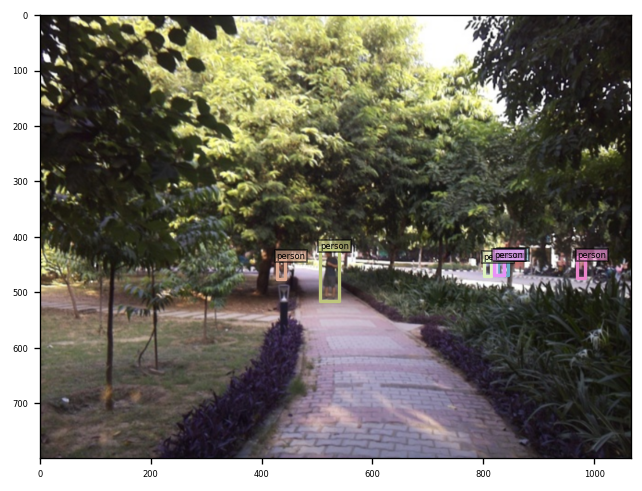

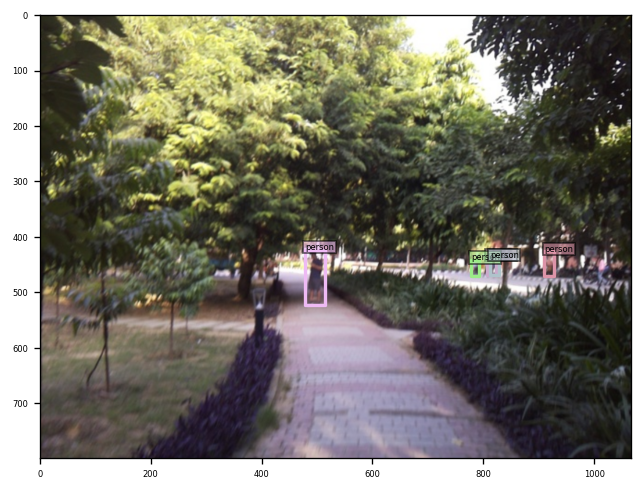

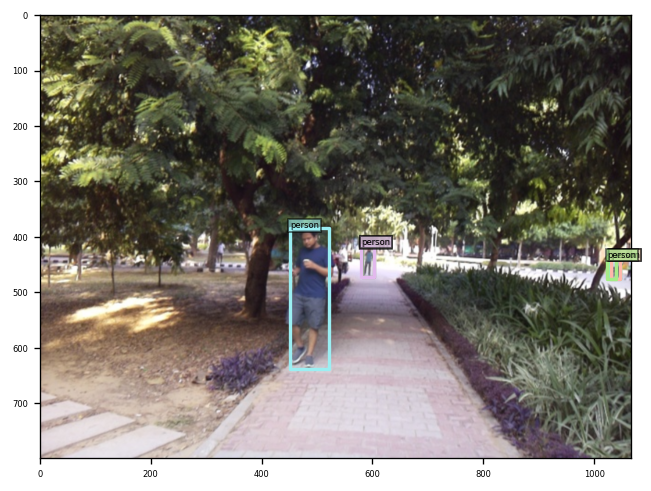

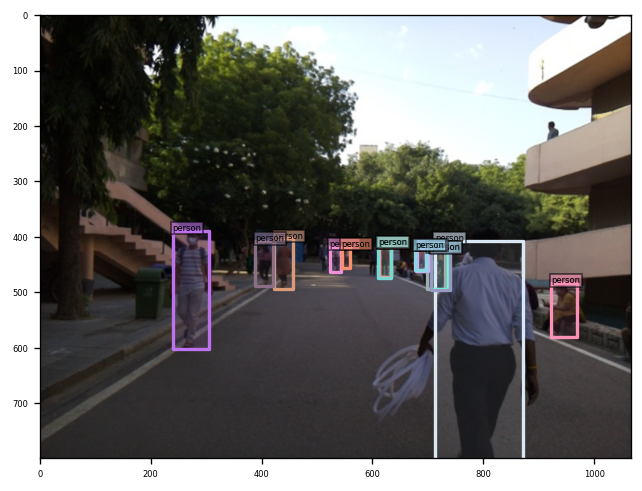

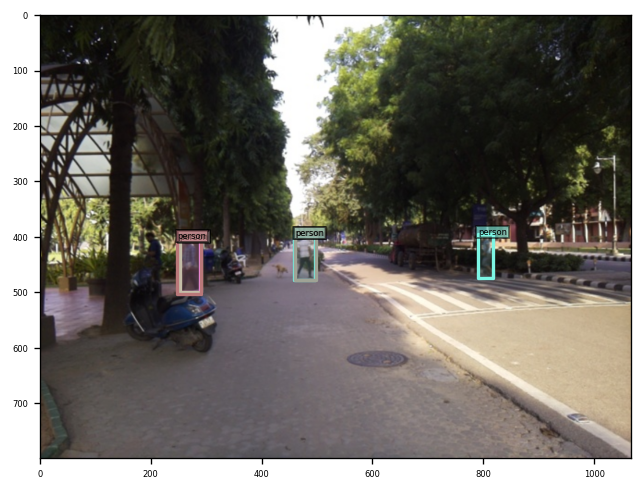

...

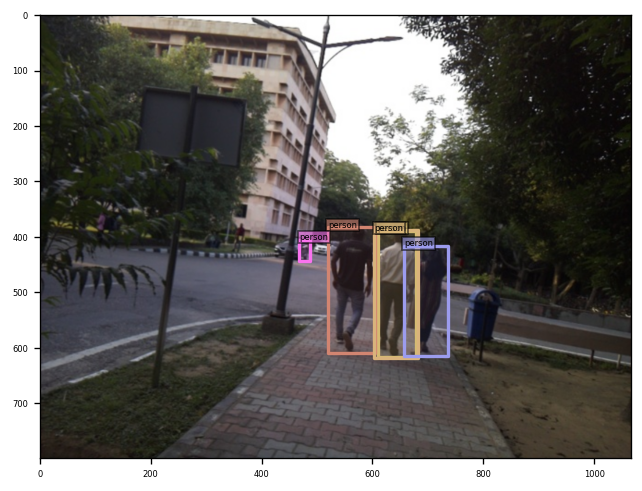

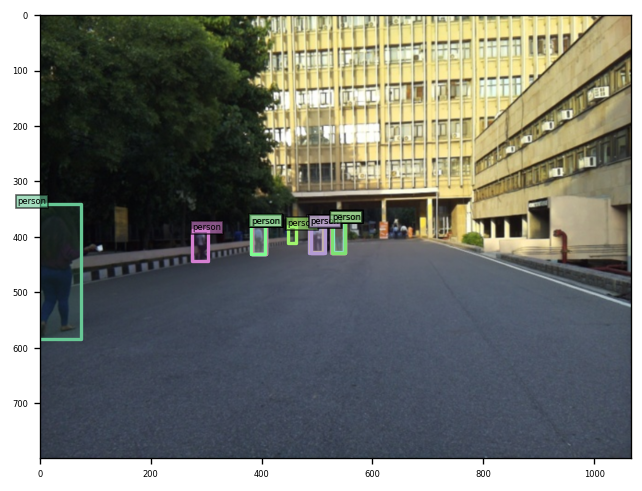

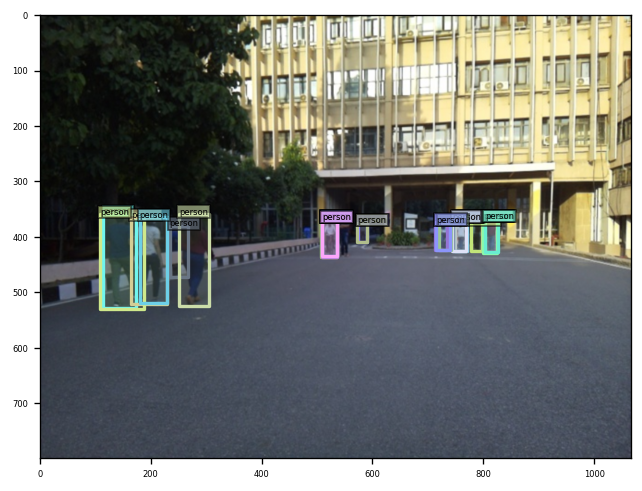

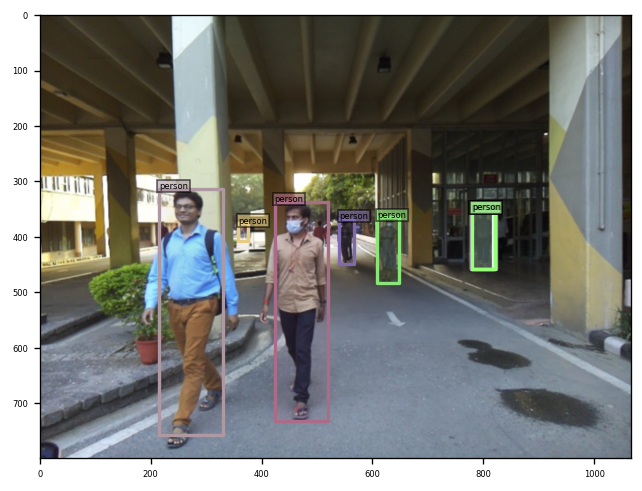

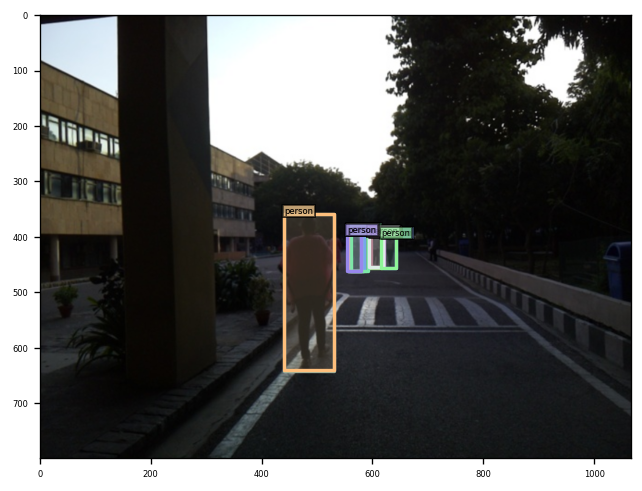

Error idx: 40


In [ ]:
iou_threshold = 0.5

# Initialize tensors for all boxes, scores, TP, and FP (empty tensors to concatenate later)
all_boxes = torch.empty((0, 4), device=device)  # Assuming (N, 4) boxes
all_scores = torch.empty(0, device=device)      # (N, ) scores
all_tp = torch.empty(0, device=device)          # (N, ) true positives
all_fp = torch.empty(0, device=device)          # (N, ) false positives
all_gt_boxes = 0

# Iterate through the validation dataset
for idx, (image, targets) in enumerate(dataset_val):

    output = model.cuda()(image[None].cuda())
    output = postprocessors['bbox'](output, torch.Tensor([[1.0, 1.0]]).cuda())[0]

    threshold = 0.3  # set a threshold

    scores = output['scores']
    labels = output['labels']
    boxes = box_ops.box_xyxy_to_cxcywh(output['boxes'])
    select_mask = scores > threshold

    box_label = [id2name[int(item)] for item in labels[select_mask]]
    pred_dict = {
        'boxes': boxes[select_mask],
        'size': targets['size'],
        'box_label': box_label
    }
    vslzr.visualize(image, pred_dict, savedir=None)

    # Filter the predictions for the "person" class
    person_mask = [label == "person" for label in box_label]
    person_boxes = boxes[select_mask][person_mask]
    person_scores = scores[select_mask][person_mask]

    # Correct way to find the index for the "person" class
    person_class_id = [key for key, value in id2name.items() if value == "person"][0]

    # Get ground truth boxes for "person"
    gt_person_mask = targets['labels'] == person_class_id
    gt_person_boxes = targets['boxes'][gt_person_mask]

    person_boxes_xyxy = cxcywh_to_xyxy(person_boxes)
    gt_person_boxes_xyxy = cxcywh_to_xyxy(gt_person_boxes)

    # Move tensors to the same device (cuda if available)
    person_boxes_abs = person_boxes_xyxy.to(device)
    gt_person_boxes_abs = gt_person_boxes_xyxy.to(device)

    # Compute IoU between predicted "person" boxes and ground truth "person" boxes
    iou_matrix = box_iou(person_boxes_abs, gt_person_boxes_abs)

    # Initialize TP and FP for current image
    tp = torch.zeros(len(person_boxes_abs), device=device)  # Start with all FP
    fp = torch.ones(len(person_boxes_abs), device=device)   # Start with all FP

    # Track matched ground truth boxes
    matched_gt = []

    for i, ious in enumerate(iou_matrix):
        max_iou = ious.max()
        if max_iou > iou_threshold and ious.argmax() not in matched_gt:
            tp[i] = 1  # True Positive
            fp[i] = 0  # Not a False Positive
            matched_gt.append(ious.argmax())  # Mark this GT as matched

    # Concatenate results for this image into the global tensors
    all_boxes = torch.cat([all_boxes, person_boxes_abs], dim=0)
    all_scores = torch.cat([all_scores, person_scores], dim=0)
    all_tp = torch.cat([all_tp, tp], dim=0)
    all_fp = torch.cat([all_fp, fp], dim=0)
    all_gt_boxes += len(gt_person_boxes)

In [ ]:
import matplotlib.pyplot as plt

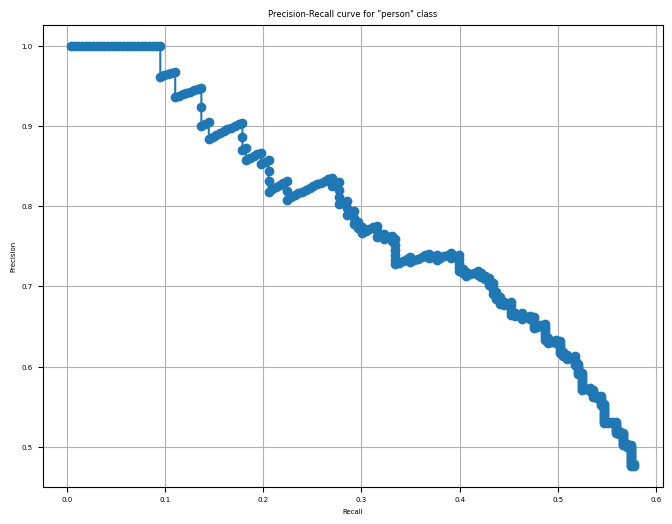

Average Precision for 'person' class: 0.4546


In [ ]:
# Concatenate results across all images
# all_scores = torch.cat(all_scores)
# all_tp = torch.cat(all_tp)
# all_fp = torch.cat(all_fp)

# Sort by scores (descending)
sorted_indices = torch.argsort(all_scores, descending=True)
all_tp = all_tp[sorted_indices]
all_fp = all_fp[sorted_indices]

# Cumulative sum of TP and FP
tp_cumsum = torch.cumsum(all_tp, dim=0)
fp_cumsum = torch.cumsum(all_fp, dim=0)

# Calculate precision and recall
precision = tp_cumsum / (tp_cumsum + fp_cumsum)
recall = tp_cumsum / all_gt_boxes

# Plot Precision-Recall curve
plt.figure(figsize=(8, 6))
plt.plot(recall.cpu(), precision.cpu(), marker='o')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall curve for "person" class')
plt.grid(True)
plt.show()

# Compute Average Precision (AP) using the trapezoidal rule
def calculate_ap(precision, recall):
    return torch.trapz(precision, recall)

ap_person = calculate_ap(precision, recall)
print(f"Average Precision for 'person' class: {ap_person.item():.4f}")